In [1]:
import pandas as pd
import numpy as np
import folium
import requests
from requests.auth import HTTPBasicAuth
import geopandas as gpd
import apikey
%matplotlib inline

In [2]:
key = apikey.apikey
request_url = "http://citysdk.commerce.gov"
PR_COORDINATES = (18, -66.3)

In [3]:
request_obj = {
    "level": "state",
    "state": "PR",
    "sublevel": True,
    "variables": [
        "B15003_002E",
        "B15003_003E",
        "B15003_004E",
        "B15003_005E",
        "B15003_006E",
        "B15003_007E",
        "B15003_008E",
        "B15003_009E",
        "B15003_010E",
        "B15003_011E",
        "B15003_012E",
        "B15003_013E",
        "B15003_014E",
        "B15003_015E",
        "B15003_016E",
        "education_associates",
        "education_bachelors",
        "education_doctorate",
        "education_ged",
        "education_high_school",
        "education_masters",
        "education_professional"
    ],
    "api": "acs5",
    "year": "2014"
}

In [4]:
response = requests.post(request_url, auth=HTTPBasicAuth(key, None), json=request_obj)

response.json

<bound method Response.json of <Response [200]>>

In [5]:
f = open('ed.json', 'wb')
f.write(response.text.encode('utf-8'))
f.close()

In [6]:
munidata = gpd.read_file('ed.json')

In [7]:
munidata['B15003_002E']

0      833
1      816
2      812
3      432
4     1115
5      265
6       21
7      675
8      526
9      437
10    5931
11     637
12     326
13     347
14    1176
15     311
16    1816
17     948
18     730
19     929
20     755
21     352
22     616
23    1043
24     428
25     169
26    1172
27     533
28    2911
29    3580
      ... 
48     267
49    1201
50     379
51    1006
52    1732
53    1838
54     567
55     413
56     738
57     602
58     787
59     624
60     473
61    1371
62     760
63     158
64     776
65     257
66     803
67     815
68     463
69    1319
70     133
71     748
72     762
73     758
74     334
75    2162
76     604
77     719
Name: B15003_002E, dtype: object

In [8]:
munidata['B15003_003E']

0     13
1      0
2      0
3      9
4      0
5      5
6      0
7      0
8      0
9     16
10    62
11     0
12     0
13     0
14     0
15     0
16     0
17     6
18     0
19     0
20     0
21    35
22     0
23     0
24     0
25     0
26    21
27    15
28    50
29    49
      ..
48     0
49     9
50     0
51    19
52    38
53     0
54     0
55    16
56     0
57    12
58    12
59     0
60     6
61    12
62     0
63     0
64    14
65     0
66     0
67     0
68     0
69    16
70     0
71    13
72     0
73    17
74     0
75    37
76    20
77     0
Name: B15003_003E, dtype: object

In [9]:
munidata['B15003_002E'] = munidata['B15003_002E'].apply(int)
munidata['B15003_003E'] = munidata['B15003_003E'].apply(int)
munidata['B15003_004E'] = munidata['B15003_004E'].apply(int)
munidata['B15003_005E'] = munidata['B15003_005E'].apply(int)
munidata['B15003_006E'] = munidata['B15003_006E'].apply(int)
munidata['B15003_007E'] = munidata['B15003_007E'].apply(int)
munidata['B15003_008E'] = munidata['B15003_008E'].apply(int)
munidata['B15003_009E'] = munidata['B15003_009E'].apply(int)
munidata['B15003_010E'] = munidata['B15003_010E'].apply(int)
munidata['B15003_011E'] = munidata['B15003_011E'].apply(int)
munidata['B15003_012E'] = munidata['B15003_012E'].apply(int)
munidata['B15003_013E'] = munidata['B15003_013E'].apply(int)
munidata['B15003_014E'] = munidata['B15003_014E'].apply(int)
munidata['B15003_015E'] = munidata['B15003_015E'].apply(int)
munidata['B15003_016E'] = munidata['B15003_016E'].apply(int)
munidata['B15003_017E'] = munidata['B15003_017E'].apply(int)
munidata['B15003_018E'] = munidata['B15003_018E'].apply(int)
munidata['B15003_021E'] = munidata['B15003_021E'].apply(int)
munidata['B15003_022E'] = munidata['B15003_022E'].apply(int)
munidata['B15003_023E'] = munidata['B15003_023E'].apply(int)
munidata['B15003_024E'] = munidata['B15003_024E'].apply(int)
munidata['B15003_025E'] = munidata['B15003_025E'].apply(int)


type(munidata['B15003_017E'].iloc[1])

numpy.int64

In [10]:
munidata['HS_GED_SUM'] = munidata['B15003_017E'] + munidata['B15003_018E']
munidata['LESS_THAN_GED'] = munidata['B15003_002E'] + munidata['B15003_003E'] + munidata['B15003_004E'] + munidata['B15003_005E'] + munidata['B15003_006E'] + munidata['B15003_007E'] + munidata['B15003_008E'] + munidata['B15003_009E'] + munidata['B15003_010E'] + munidata['B15003_011E'] + munidata['B15003_012E'] + munidata['B15003_013E'] + munidata['B15003_014E'] + munidata['B15003_015E'] + munidata['B15003_016E']

In [11]:
munidata['HS_GED_SUM']

0      8972
1      4395
2      5463
3      7503
4      7161
5      3632
6       341
7      6113
8      5046
9      3730
10    54906
11     6570
12     5079
13     4391
14    11343
15     3620
16    16442
17     9406
18     4521
19     5459
20     8104
21     4223
22     5251
23     7793
24     3220
25     1592
26    10742
27     5324
28    30387
29    32083
      ...  
48     6831
49    16993
50     6764
51     9326
52    18642
53    29949
54     5761
55     3770
56     7783
57     6952
58     6152
59     9385
60     5326
61    12451
62     5337
63     1816
64    11018
65     4516
66     9081
67     8694
68     4120
69     6329
70     3369
71     4375
72     4045
73     5832
74     5293
75    24091
76     5686
77     5728
Name: HS_GED_SUM, dtype: int64

In [12]:
mapa0 = folium.Map(location=PR_COORDINATES, zoom_start=9)

mapa0.choropleth(
    geo_str=munidata.to_json(),    data=munidata,
    columns=['BASENAME', 'LESS_THAN_GED'],
    key_on='feature.properties.BASENAME',
    fill_color='YlOrRd',
    legend_name='Less that GED Quantity',
    )

mapa0

/usr/lib/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:8: FutureWarning: 'threshold_scale' default behavior has changed. Now you get a linear scale between the 'min' and the 'max' of your data. To get former behavior, use folium.utilities.split_six.


In [13]:
mapa1 = folium.Map(location=PR_COORDINATES, zoom_start=9)

mapa1.choropleth(
    geo_str=munidata.to_json(),    data=munidata,
    columns=['BASENAME', 'HS_GED_SUM'],
    key_on='feature.properties.BASENAME',
    fill_color='YlOrRd',
    legend_name='HS/GED Quantity',
    )



/usr/lib/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:8: FutureWarning: 'threshold_scale' default behavior has changed. Now you get a linear scale between the 'min' and the 'max' of your data. To get former behavior, use folium.utilities.split_six.


In [14]:
mapa1

In [15]:
mapa2 = folium.Map(location=PR_COORDINATES, zoom_start=9)

mapa2.choropleth(
    geo_str=munidata.to_json(),    data=munidata,
    columns=['BASENAME', 'B15003_021E'],
    key_on='feature.properties.BASENAME',
    fill_color='YlOrRd',
    legend_name='Associate Degree Quantity',
    )

mapa2

/usr/lib/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:8: FutureWarning: 'threshold_scale' default behavior has changed. Now you get a linear scale between the 'min' and the 'max' of your data. To get former behavior, use folium.utilities.split_six.


In [16]:
mapa3 = folium.Map(location=PR_COORDINATES, zoom_start=9)

mapa3.choropleth(
    geo_str=munidata.to_json(),    data=munidata,
    columns=['BASENAME', 'B15003_022E'],
    key_on='feature.properties.BASENAME',
    fill_color='YlOrRd',
    legend_name='Bachelor Degree Quantity',
    )

mapa3

/usr/lib/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:8: FutureWarning: 'threshold_scale' default behavior has changed. Now you get a linear scale between the 'min' and the 'max' of your data. To get former behavior, use folium.utilities.split_six.


In [17]:
mapa4 = folium.Map(location=PR_COORDINATES, zoom_start=9)

mapa4.choropleth(
    geo_str=munidata.to_json(),    data=munidata,
    columns=['BASENAME', 'B15003_023E'],
    key_on='feature.properties.BASENAME',
    fill_color='YlOrRd',
    legend_name='Master Degree Quantity',
    )

mapa4

/usr/lib/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:8: FutureWarning: 'threshold_scale' default behavior has changed. Now you get a linear scale between the 'min' and the 'max' of your data. To get former behavior, use folium.utilities.split_six.


In [18]:
mapa5 = folium.Map(location=PR_COORDINATES, zoom_start=9)

mapa5.choropleth(
    geo_str=munidata.to_json(),    data=munidata,
    columns=['BASENAME', 'B15003_024E'],
    key_on='feature.properties.BASENAME',
    fill_color='YlOrRd',
    legend_name='Professional Degree Quantity',
    )

mapa5

/usr/lib/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:8: FutureWarning: 'threshold_scale' default behavior has changed. Now you get a linear scale between the 'min' and the 'max' of your data. To get former behavior, use folium.utilities.split_six.


In [19]:
mapa6 = folium.Map(location=PR_COORDINATES, zoom_start=9)

mapa6.choropleth(
    geo_str=munidata.to_json(),    data=munidata,
    columns=['BASENAME', 'B15003_025E'],
    key_on='feature.properties.BASENAME',
    fill_color='YlOrRd',
    legend_name='Doctorate Degree Quantity',
    )

mapa6

/usr/lib/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:8: FutureWarning: 'threshold_scale' default behavior has changed. Now you get a linear scale between the 'min' and the 'max' of your data. To get former behavior, use folium.utilities.split_six.


In [20]:
# run the command below after saving the jupiter notebook to generate a static html that you can share
# !jupyter nbconvert census01.ipynb --to html

In [21]:
!jupyter nbconvert census01.ipynb --to html

[NbConvertApp] Converting notebook census01.ipynb to html
[NbConvertApp] Writing 284535 bytes to census01.html


In [22]:
munidata


,AREALAND,AREAWATER,B15003_002E,B15003_003E,B15003_004E,B15003_005E,B15003_006E,B15003_007E,B15003_008E,B15003_009E,...,INTPTLAT,INTPTLON,LSADC,MTFCC,NAME,OID,STATE,geometry,HS_GED_SUM,LESS_THAN_GED
0,87748363,32509,833,13,0,67,223,567,611,246,...,+18.1871483,-065.8711890,13,G4020,"Las Piedras Municipio, Puerto Rico",2759095169576,72,POLYGON ((-65.91047600033885 18.17474800016364...,8972,6718
1,58747684,30224116,816,0,18,168,234,318,380,226,...,+18.4663570,-066.9276025,13,G4020,"Quebradillas Municipio, Puerto Rico",2759094671511,72,POLYGON ((-66.95674900042195 18.49219500042559...,4395,5443
2,70969182,898339,812,0,0,119,272,396,432,335,...,+18.2899273,-066.2534402,13,G4020,"Naranjito Municipio, Puerto Rico",275901169807067,72,"POLYGON ((-66.2853179997286 18.30376900028859,...",5463,5948
3,77448648,195352764,432,9,0,71,103,330,297,196,...,+18.3863776,-065.5884540,13,G4020,"Fajardo Municipio, Puerto Rico",27590596825496,72,POLYGON ((-65.68416599999233 18.32375399970039...,7503,5231
4,143005178,72592521,1115,0,0,93,370,527,770,346,...,+18.0598584,-065.8598713,13,G4020,"Yabucoa Municipio, Puerto Rico",27590133826971,72,POLYGON ((-65.94290999976045 18.08924299968265...,7161,8553
5,29384893,481,265,5,16,113,131,303,398,205,...,+18.1346949,-067.1161994,13,G4020,"Hormigueros Municipio, Puerto Rico",27590270217806,72,POLYGON ((-67.13650700018823 18.13301299966263...,3632,3695
6,30115057,407158804,21,0,0,0,0,12,44,112,...,+18.3265989,-065.3077200,13,G4020,"Culebra Municipio, Puerto Rico",2759083439319,72,POLYGON ((-65.37056899958179 18.26128600014639...,341,442
7,59799556,79309325,675,0,0,140,253,385,408,251,...,+18.4726608,-066.2595854,13,G4020,"Dorado Municipio, Puerto Rico",2759083455808,72,POLYGON ((-66.31464899986821 18.47810500037599...,6113,6156
8,94050252,25323,526,0,0,164,293,470,579,332,...,+18.0843613,-066.9476668,13,G4020,"Sabana Grande Municipio, Puerto Rico",27590608445550,72,POLYGON ((-66.98060200029715 18.07877499962033...,5046,5235
9,172310084,459605,437,16,0,95,107,288,309,384,...,+18.2959127,-066.5155884,13,G4020,"Ciales Municipio, Puerto Rico",2759083237657,72,POLYGON ((-66.58344000031906 18.33912899985486...,3730,4410


In [23]:
munidata.describe()

,AREALAND,AREAWATER,B15003_002E,B15003_003E,B15003_004E,B15003_005E,B15003_006E,B15003_007E,B15003_008E,B15003_009E,...,B15003_017E,B15003_018E,B15003_021E,B15003_022E,B15003_023E,B15003_024E,B15003_025E,OID,HS_GED_SUM,LESS_THAN_GED
count,7.800000e+01,7.800000e+01,78.000000,78.000000,78.000000,78.000000,78.000000,78.000000,78.000000,78.000000,...,78.000000,78.000000,78.000000,78.000000,78.000000,78.000000,78.000000,7.800000e+01,78.000000,78.000000
mean,1.136936e+08,6.311767e+07,863.012821,7.641026,8.756410,175.371795,276.846154,562.897436,722.820513,471.692308,...,7451.397436,887.371795,2833.730769,5311.294872,1384.948718,395.153846,271.000000,2.472519e+13,8338.769231,8749.051282
std,5.840925e+07,1.076395e+08,825.337971,13.327030,18.291426,132.735173,236.181972,455.588975,689.893060,387.008584,...,7233.794915,1008.014251,3524.332103,7714.775214,2431.589774,1317.795277,595.851895,5.202167e+13,8079.989059,8033.411090
min,1.264842e+07,4.810000e+02,21.000000,0.000000,0.000000,0.000000,0.000000,12.000000,44.000000,63.000000,...,308.000000,33.000000,79.000000,78.000000,14.000000,0.000000,1.000000,2.759082e+12,341.000000,442.000000
25%,7.256070e+07,3.828928e+05,428.500000,0.000000,0.000000,90.750000,131.750000,306.750000,371.000000,240.750000,...,3915.000000,328.250000,1204.000000,2033.250000,397.250000,41.250000,40.250000,2.759083e+12,4392.000000,4893.250000
50%,1.088466e+08,2.776630e+07,724.500000,0.000000,0.000000,141.000000,231.000000,463.500000,570.000000,383.000000,...,5282.000000,607.500000,1904.000000,3005.000000,682.500000,83.000000,94.000000,1.517461e+13,5972.500000,6991.000000
75%,1.425401e+08,7.526007e+07,1033.750000,12.000000,10.750000,226.750000,325.000000,693.250000,787.250000,572.250000,...,7807.250000,995.000000,2980.500000,5058.750000,1172.500000,208.250000,213.750000,2.759054e+13,8922.500000,9802.500000
max,3.261971e+08,5.522064e+08,5931.000000,62.000000,86.000000,782.000000,1481.000000,3389.000000,5139.000000,2819.000000,...,50692.000000,5779.000000,25094.000000,55954.000000,18598.000000,10744.000000,4629.000000,2.759012e+14,54906.000000,60138.000000


In [24]:
munidata.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 78 entries, 0 to 77
Data columns (total 42 columns):
AREALAND         78 non-null int64
AREAWATER        78 non-null int64
B15003_002E      78 non-null int64
B15003_003E      78 non-null int64
B15003_004E      78 non-null int64
B15003_005E      78 non-null int64
B15003_006E      78 non-null int64
B15003_007E      78 non-null int64
B15003_008E      78 non-null int64
B15003_009E      78 non-null int64
B15003_010E      78 non-null int64
B15003_011E      78 non-null int64
B15003_012E      78 non-null int64
B15003_013E      78 non-null int64
B15003_014E      78 non-null int64
B15003_015E      78 non-null int64
B15003_016E      78 non-null int64
B15003_017E      78 non-null int64
B15003_018E      78 non-null int64
B15003_021E      78 non-null int64
B15003_022E      78 non-null int64
B15003_023E      78 non-null int64
B15003_024E      78 non-null int64
B15003_025E      78 non-null int64
BASENAME         78 non-null object
CENTLAT      

In [25]:
!jupyter nbconvert census01.ipynb --to html

[NbConvertApp] Converting notebook census01.ipynb to html
[NbConvertApp] Writing 284535 bytes to census01.html


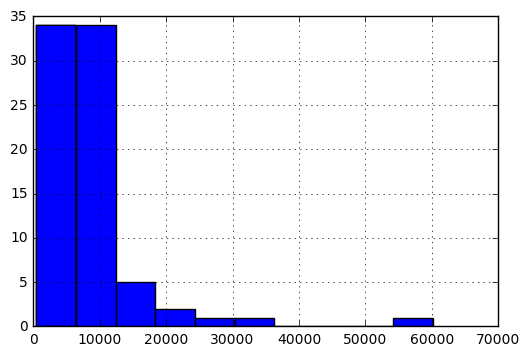

In [26]:

munidata['LESS_THAN_GED'].hist()

In [27]:
sc